In [14]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report
import joblib
import json
import pandas as pd

In [6]:
# Membaca file JSON
with open('student_validations.json') as file:
    data = json.load(file)
    
# Mengambil data dari JSON
table_data = data[2]['data']

# Mengubah data menjadi DataFrame pandas
df = pd.DataFrame(table_data)

# Menampilkan beberapa baris data untuk memastikan sudah benar
print(df.head())

# Mengecek distribusi status
print(df['status'].value_counts())

     id userid testid  status  \
0  6144    154     24  FAILED   
1  5378    119     24  PASSED   
2  6914    418     24  PASSED   
3  6404    320     24  FAILED   
4  5126    260     24  PASSED   

                                              report duration  \
0  1. checkActivityName -> FAILED -> android.view...       16   
1  1. checkActivityName -> PASSED -> Success\n2. ...       23   
2  1. checkActivityName -> PASSED -> Success\n2. ...       33   
3  1. checkActivityName -> FAILED -> android.view...       16   
4  1. checkActivityName -> PASSED -> Success\n2. ...       23   

            created_at updated_at  
0  2020-03-31 05:30:31       None  
1  2020-03-30 23:56:48       None  
2  2020-03-31 20:18:58       None  
3  2020-03-31 07:19:36       None  
4  2020-03-30 22:05:29       None  
status
PASSED    26310
ERROR      1468
FAILED     1282
            959
Name: count, dtype: int64


In [9]:
# Memfilter data dengan status 'FAILED' and 'ERROR'
failed_data = df[(df['status'] == 'FAILED') | (df['status'] == 'ERROR')]

# Melihat distribusi testid pada data yang gagal
print(failed_data['testid'].value_counts())

testid
381    71
402    68
66     66
401    60
397    52
       ..
377     1
108     1
107     1
150     1
117     1
Name: count, Length: 240, dtype: int64


d:\anaconda3\envs\test_report_env\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 9 (	) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


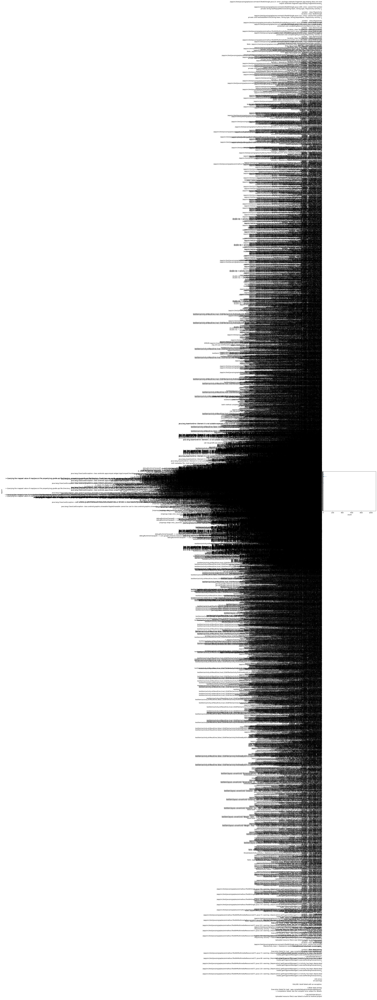

In [10]:
# Membuat visualisasi untuk melihat distribusi report pada data yang gagal
sns.countplot(y='report', data=failed_data)
plt.show()


In [11]:
# Memisahkan fitur dan label
X = failed_data[['testid']]
y = failed_data['report']

In [15]:
# Membagi data menjadi data latih dan data uji
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Membuat model Decision Tree
model = DecisionTreeClassifier()
model.fit(X_train, y_train)

# Prediksi pada data uji
y_pred = model.predict(X_test)


In [16]:
# Evaluasi model
print(classification_report(y_test, y_pred))

# Simpan model jika diperlukan
joblib.dump(model, 'test_report_model.pkl')

d:\anaconda3\envs\test_report_env\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\envs\test_report_env\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\envs\test_report_env\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\envs\test_report_env\li

d:\anaconda3\envs\test_report_env\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\envs\test_report_env\lib\site-packages\sklearn\metrics\_classification.py:1469: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


['test_report_model.pkl']